<a href="https://colab.research.google.com/github/MelikaRad/Image_Colorization_Using_GAN/blob/main/Landscape_Colorization_Using_GAN_200_epoch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Colorization using GAN
Melika Heydari Rad

___

In [ ]:
from PIL import Image
from sklearn.model_selection import train_test_split
import tensorflow as tf
import numpy as np
from matplotlib import image
from matplotlib import pyplot as plt
import os
from tensorflow import keras
# from tensorflow.keras import layers

# The batch size we'll use for training
batch_size = 16

# Size of the image required to train our model
image_size = 200 # as it is


# These many images will be used from the data archive
# dataset_split = 1000


In [ ]:
# Loading train

train_y_dir = "drive/MyDrive/Landscape_Dataset/train_y"
train_x_dir = "drive/MyDrive/Landscape_Dataset/train_x"

train_x = []
train_y = []

for i, image_file in enumerate(os.listdir( train_y_dir )):
    rgb_image = Image.open( os.path.join( train_y_dir , image_file ) )
    # Normalize the RGB image array
    rgb_img_array = (np.asarray( rgb_image ) ) / 255
    train_y.append( rgb_img_array )


for i, image_file in enumerate(os.listdir( train_x_dir )):
    gray_image = Image.open( os.path.join( train_x_dir , image_file ) )
    # Normalize the RGB image array
    gray_img_array = (np.asarray( gray_image ).reshape( ( image_size , image_size , 1 ) )) / 255
    train_x.append( gray_img_array )

In [ ]:
# loading test

test_y_dir = "drive/MyDrive/Landscape_Dataset/test_y"
test_x_dir = "drive/MyDrive/Landscape_Dataset/test_x"

test_x = []
test_y = []

for i, image_file in enumerate(os.listdir( test_y_dir )):
    rgb_image = Image.open( os.path.join( test_y_dir , image_file ) )
    # Normalize the RGB image array
    rgb_img_array = (np.asarray( rgb_image ) ) / 255
    test_y.append( rgb_img_array )


for i, image_file in enumerate(os.listdir( test_x_dir )):
    gray_image = Image.open( os.path.join( test_x_dir , image_file ) )
    # Normalize the RGB image array
    gray_img_array = (np.asarray( gray_image ).reshape( ( image_size , image_size , 1 ) )) / 255
    test_x.append( gray_img_array )

In [ ]:
print(len(train_x))
print(len(train_y))
print(len(test_x))
print(len(test_y))

880
880
100
100


In [ ]:
train_x = np.array(train_x)
train_y = np.array(train_y)
test_x = np.array(test_x)
test_y = np.array(test_y)

In [ ]:
print(train_x.shape)
print(train_y.shape)
print(test_x.shape)
print(test_y.shape)

(880, 200, 200, 1)
(880, 200, 200, 3)
(100, 200, 200, 1)
(100, 200, 200, 3)


In [ ]:
# Construct tf.data.Dataset object
dataset = tf.data.Dataset.from_tensor_slices( ( train_x , train_y ) ).batch(batch_size)

In [ ]:
def get_generator_model():

    inputs = tf.keras.layers.Input( shape=( image_size , image_size , 1 ) )

    conv1 = tf.keras.layers.Conv2D( 16 , kernel_size=( 5 , 5 ) , strides=1 )( inputs )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) , strides=1)( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )
    conv1 = tf.keras.layers.Conv2D( 32 , kernel_size=( 3 , 3 ) , strides=1)( conv1 )
    conv1 = tf.keras.layers.LeakyReLU()( conv1 )

    conv2 = tf.keras.layers.Conv2D( 32 , kernel_size=( 5 , 5 ) , strides=1)( conv1 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) , strides=1 )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )
    conv2 = tf.keras.layers.Conv2D( 64 , kernel_size=( 3 , 3 ) , strides=1 )( conv2 )
    conv2 = tf.keras.layers.LeakyReLU()( conv2 )

    conv3 = tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1 )( conv2 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )
    conv3 = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 )( conv3 )
    conv3 = tf.keras.layers.LeakyReLU()( conv3 )

    bottleneck = tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='tanh' , padding='same' )( conv3 )

    concat_1 = tf.keras.layers.Concatenate()( [ bottleneck , conv3 ] )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( concat_1 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 128 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( conv_up_3 )
    conv_up_3 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu' )( conv_up_3 )

    concat_2 = tf.keras.layers.Concatenate()( [ conv_up_3 , conv2 ] )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( concat_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 64 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu' )( conv_up_2 )
    conv_up_2 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu' )( conv_up_2 )

    concat_3 = tf.keras.layers.Concatenate()( [ conv_up_2 , conv1 ] )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu')( concat_3 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 32 , kernel_size=( 3 , 3 ) , strides=1 , activation='relu')( conv_up_1 )
    conv_up_1 = tf.keras.layers.Conv2DTranspose( 3 , kernel_size=( 5 , 5 ) , strides=1 , activation='relu')( conv_up_1 )

    model = tf.keras.models.Model( inputs , conv_up_1 )
    return model


In [ ]:
def get_discriminator_model():
    layers = [
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7 , 7 ) , strides=1 , activation='relu' , input_shape=( 200 , 200 , 3 ) ),
        tf.keras.layers.Conv2D( 32 , kernel_size=( 7, 7 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 64 , kernel_size=( 5 , 5 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 128 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.Conv2D( 256 , kernel_size=( 3 , 3 ) , strides=1, activation='relu'  ),
        tf.keras.layers.MaxPooling2D(),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense( 512, activation='relu'  )  ,
        tf.keras.layers.Dense( 128 , activation='relu' ) ,
        tf.keras.layers.Dense( 16 , activation='relu' ) ,
        tf.keras.layers.Dense( 1 , activation='sigmoid' )
    ]
    model = tf.keras.models.Sequential( layers )
    return model


In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
mse = tf.keras.losses.MeanSquaredError()

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) - tf.random.uniform( shape=real_output.shape , maxval=0.1 ) , real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output) + tf.random.uniform( shape=fake_output.shape , maxval=0.1  ) , fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output , real_y):
    real_y = tf.cast( real_y , 'float32' )
    return mse( fake_output , real_y )

generator_optimizer = tf.keras.optimizers.Adam( 0.0005 )
discriminator_optimizer = tf.keras.optimizers.Adam( 0.0005 )

generator = get_generator_model()
discriminator = get_discriminator_model()


In [ ]:
@tf.function
def train_step( input_x , real_y ):

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate an image -> G( x )
        generated_images = generator( input_x , training=True)
        # Probability that the given image is real -> D( x )
        real_output = discriminator( real_y, training=True)
        # Probability that the given image is the one generated -> D( G( x ) )
        generated_output = discriminator(generated_images, training=True)

        # L2 Loss -> || y - G(x) ||^2
        gen_loss = generator_loss( generated_images , real_y )
        # Log loss for the discriminator
        disc_loss = discriminator_loss( real_output, generated_output )

    #tf.keras.backend.print_tensor( tf.keras.backend.mean( gen_loss ) )
    #tf.keras.backend.print_tensor( gen_loss + disc_loss )

    # Compute the gradients
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # Optimize with Adam
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))


In [ ]:
num_epochs = 200

for e in range( num_epochs ):
    print( "epoch no.: ", e )
    for ( x , y ) in dataset:
        # Here ( x , y ) represents a batch from our training dataset.
        # print( x.shape )
        train_step( x , y )

epoch no.:  0
epoch no.:  1
epoch no.:  2
epoch no.:  3
epoch no.:  4
epoch no.:  5
epoch no.:  6
epoch no.:  7
epoch no.:  8
epoch no.:  9
epoch no.:  10
epoch no.:  11
epoch no.:  12
epoch no.:  13
epoch no.:  14
epoch no.:  15
epoch no.:  16
epoch no.:  17
epoch no.:  18
epoch no.:  19
epoch no.:  20
epoch no.:  21
epoch no.:  22
epoch no.:  23
epoch no.:  24
epoch no.:  25
epoch no.:  26
epoch no.:  27
epoch no.:  28
epoch no.:  29
epoch no.:  30
epoch no.:  31
epoch no.:  32
epoch no.:  33
epoch no.:  34
epoch no.:  35
epoch no.:  36
epoch no.:  37
epoch no.:  38
epoch no.:  39
epoch no.:  40
epoch no.:  41
epoch no.:  42
epoch no.:  43
epoch no.:  44
epoch no.:  45
epoch no.:  46
epoch no.:  47
epoch no.:  48
epoch no.:  49
epoch no.:  50
epoch no.:  51
epoch no.:  52
epoch no.:  53
epoch no.:  54
epoch no.:  55
epoch no.:  56
epoch no.:  57
epoch no.:  58
epoch no.:  59
epoch no.:  60
epoch no.:  61
epoch no.:  62
epoch no.:  63
epoch no.:  64
epoch no.:  65
epoch no.:  66
epoch

In [ ]:
tf.keras.models.save_model(generator, 'drive/MyDrive/GAN_Colorization/MelikaRad_generator_model_Landscape_batch16_epoch200.h5')
# generator = tf.keras.models.load_model('drive/MyDrive/GAN_Colorization/generator_model_main_version_batch32.h5')

<ipython-input-13-bb14a47367dc>:1: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  tf.keras.models.save_model(generator, 'drive/MyDrive/GAN_Colorization/MelikaRad_generator_model_Landscape_batch16_epoch200.h5')


In [ ]:
tf.keras.models.save_model(discriminator, 'drive/MyDrive/GAN_Colorization/MelikaRad_discriminator_model_Landscape_batch16_epoch200.h5')
# discriminator = tf.keras.models.load_model('drive/MyDrive/GAN_Colorization/MelikaRad_discriminator_model_Landscape_batch16_epoch200.h5')

<ipython-input-14-c8291a89d46b>:1: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  tf.keras.models.save_model(discriminator, 'drive/MyDrive/GAN_Colorization/MelikaRad_discriminator_model_Landscape_batch16_epoch200.h5')


In [ ]:
y = generator( test_x ).numpy()

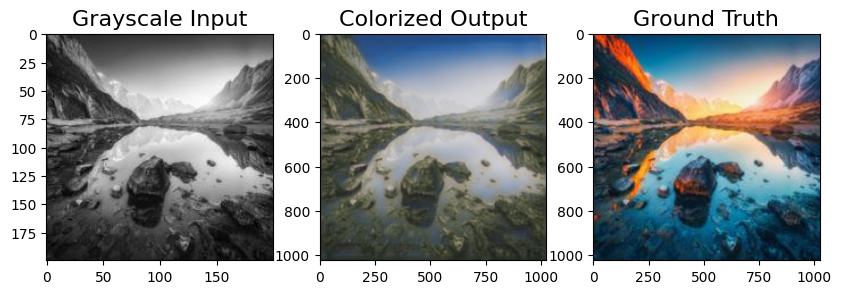

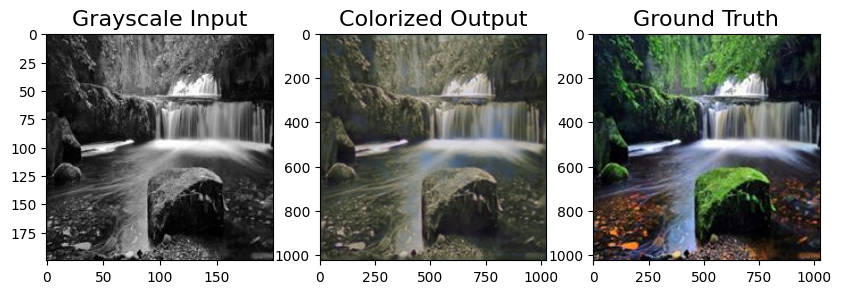

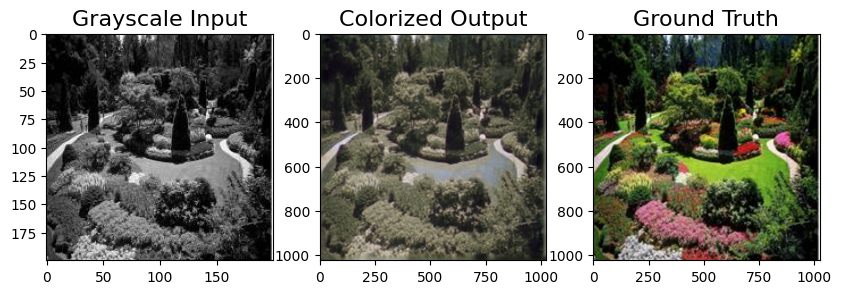

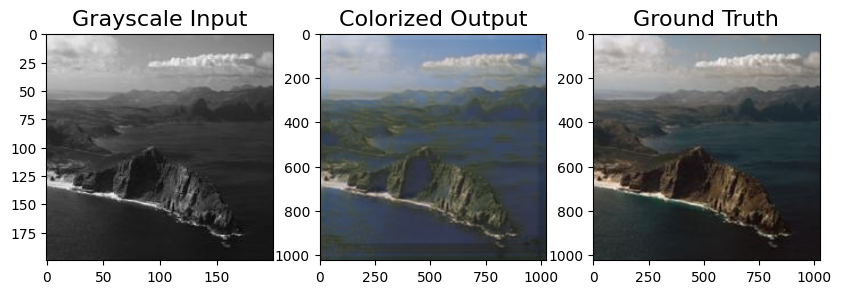

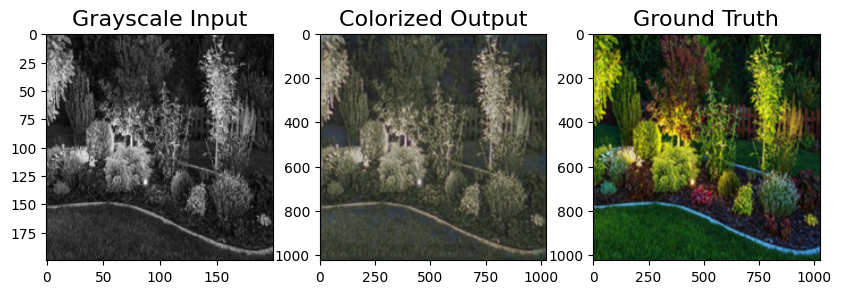

...

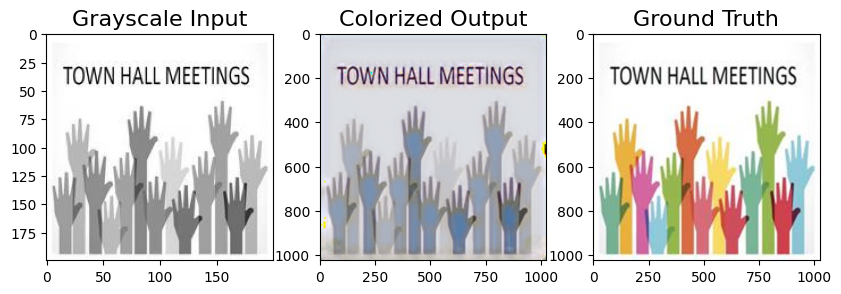

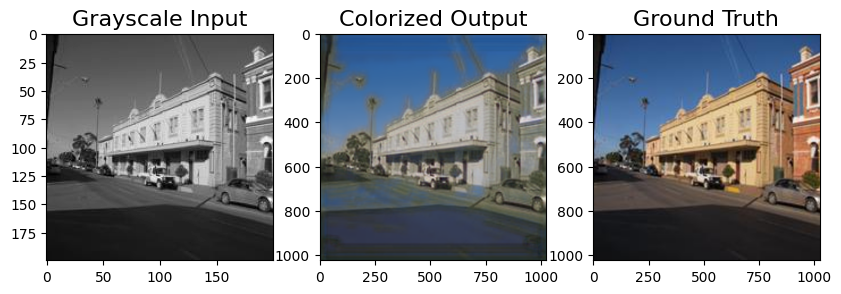

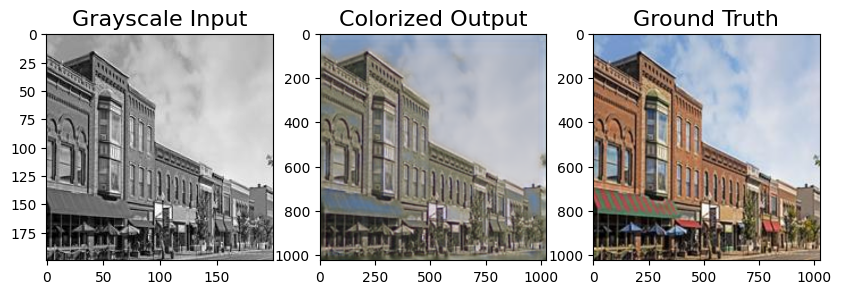

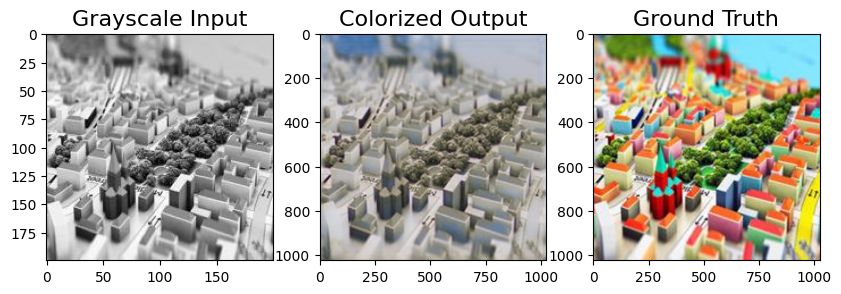

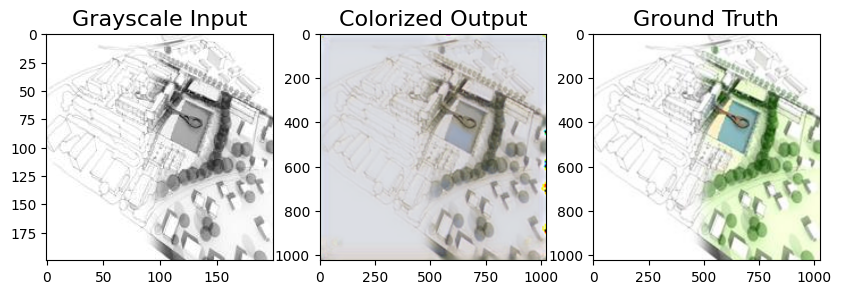

In [ ]:
for i in range(len(test_x)):
    plt.figure(figsize=(10,10))
    or_image = plt.subplot(3,3,1)
    or_image.set_title('Grayscale Input', fontsize=16)
    plt.imshow( test_x[i].reshape((200,200)) , cmap='gray' )

    in_image = plt.subplot(3,3,2)
    image = Image.fromarray( ( y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
    image = np.asarray( image )
    in_image.set_title('Colorized Output', fontsize=16)
    plt.imshow( image )

    ou_image = plt.subplot(3,3,3)
    image = Image.fromarray( ( test_y[i] * 255 ).astype( 'uint8' ) ).resize( ( 1024 , 1024 ) )
    ou_image.set_title('Ground Truth', fontsize=16)
    plt.imshow( image )

    plt.show()